# Import libraries

In [47]:
import os
import warnings

import numpy as np
import pandas as pd

import math

import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.cm as cm
import matplotlib.colors as mcolors

import seaborn as sns

import inspect

from matplotlib import patches as mpatches
from matplotlib.lines import Line2D
from mpl_toolkits.axes_grid1 import make_axes_locatable

from tqdm import tqdm

from sklearn.decomposition import PCA
from sklearn.decomposition import NMF
from sklearn.manifold import TSNE
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA

In [2]:
warnings.filterwarnings("ignore")

pd.set_option('display.max_columns', 50)

In [3]:
path_to_save = './../results/02a_eda'

# Loading data

In [4]:
path_to_ftir_data= './../data/preprocessed_data/scaled_data'
path_to_samples_description = './../data/parsed_data/samples_description.csv'

## FTIR-spectra (*scaled*)

In [5]:
files = os.listdir(path_to_ftir_data)

In [6]:
data_scaled_ranges = {}

for file in files:
    startswith_ftir_flg = file.startswith("ftir")

    if not startswith_ftir_flg:
        continue
    
    high_boundary = int(file.split('_')[-2])
    low_boundary = int(file.split('_')[-1].split('.')[0])

    wn_range = (high_boundary, low_boundary)
    tmp_data = pd.read_csv(f'{path_to_ftir_data}/{file}', sep=';', index_col=0)
    tmp_data.columns = tmp_data.columns.astype(float)

    data_scaled_ranges[wn_range] = tmp_data

    print(
        f'-' * 224,
        f'WAVENUMBER RANGE: {wn_range}',
        f'(*) data set shape: {data_scaled_ranges[wn_range].shape}',
        f'(*) Wavenumber for data (max/min): {round(data_scaled_ranges[wn_range].columns.max()), round(data_scaled_ranges[wn_range].columns.min())}',
        sep='\n'
    )

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WAVENUMBER RANGE: (1800, 1500)
(*) data set shape: (75, 311)
(*) Wavenumber for data (max/min): (1800, 1501)
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WAVENUMBER RANGE: (1500, 1300)
(*) data set shape: (75, 207)
(*) Wavenumber for data (max/min): (1500, 1301)
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WAVENUMBER RANGE: (3800, 2500)
(*) data set shape: (75, 1348)
(*) Wavenumber for data (max/min): (3800, 250

## Samples description

In [7]:
samples_description = pd.read_csv(f'{path_to_samples_description}', sep=';', index_col=0)

print(samples_description.shape)
samples_description.head(3)

(75, 6)


,Row_ID,Division,Size,Fraction_hue,Fraction_grouped_hue,Class
division_1_size_bulk,1,1,bulk,$> 0$,$d > 5$,2
division_1_size_5,2,1,5,$< 5$,$2 < d \leq 5$,1
division_1_size_3,3,1,3,$< 3$,$2 < d \leq 5$,1


# Data visualization

In [8]:
sns.set_theme()

mpl.rcParams.update({
    "font.family": ["Comic Sans MS", "DejaVu Sans", "Arial"],
    "axes.spines.top": False,
    "axes.spines.right": False,
})

## Spectral ranges analysis

In [9]:
type_color_dict = {
    r'$d \leq 2$': '#2166AC',
    r'$2 < d \leq 5$': '#67A9CF',
    r'$d > 5$': '#B2182B'
}

In [10]:
divisions_lst = sorted(samples_description['Division'].unique())
print(divisions_lst)

[np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7), np.int64(8), np.int64(9), np.int64(10)]


### Base functions

#### Spectrum plotting

In [11]:
def plot_spectra(data_vis, ax, samples_description=None, hue_column=None, style_params=None, plot_params=None, legend_params=None):

    # Errors when config-dicts are not provided
    if style_params is None:
        raise ValueError("style_params must be provided explicitly (no defaults).")
    if plot_params is None:
        raise ValueError("plot_params must be provided explicitly (no defaults).")
    if legend_params is None:
        raise ValueError("legend_params must be provided explicitly (no defaults).")

    # Setting colors & labels
    cmap_param = plot_params["COLORMAP"]

    if samples_description is not None and hue_column is not None:
        hue = samples_description.loc[data_vis.index, hue_column].astype(str)
        uniq = hue.unique()

        if isinstance(cmap_param, dict):
            cmap = cmap_param
        else:
            colors = cm.get_cmap(cmap_param)(np.linspace(0.2, 1.0, len(uniq)))
            cmap = dict(zip(uniq, colors))

        plot_data = [(idx, hue[idx], cmap.get(hue[idx], "#000000")) for idx in data_vis.index]
    else:
        fracs = sorted(
            data_vis.index,
            key=lambda x: float(x.split('_')[-1].replace('bulk', '1000')),
            reverse=True
        )
        cmap_name = cmap_param if not isinstance(cmap_param, dict) else "bwr"
        colors = cm.get_cmap(cmap_name)(np.linspace(0.2, 1.0, len(fracs)))
        labels = [r'$> 0$' if f.split('_')[-1] == 'bulk' else rf'$< {f.split("_")[-1]}$' for f in fracs]
        plot_data = list(zip(fracs, labels, colors))

    # Plotting
    seen = set()
    for idx, label, color in plot_data:
        ax.plot(
            data_vis.columns, data_vis.loc[idx],
            label=None if label in seen else label,
            alpha=plot_params["ALPHA"], color=color, linewidth=plot_params["LINEWIDTH"]
        )
        seen.add(label)

    # Figure style
    ax.set_title(plot_params["TITLE"], fontsize=style_params["TITLE_FONT_SIZE"], fontstyle='normal')
    ax.set_xlabel(plot_params['X_LABEL'], fontsize=style_params["X_LABEL_FONT_SIZE"], labelpad=plot_params["X_LABELPAD"])
    ax.set_ylabel(plot_params['Y_LABEL'], fontsize=style_params["Y_LABEL_FONT_SIZE"],
                  labelpad=plot_params["Y_LABELPAD"], rotation=0)
    ax.tick_params(axis='x', labelsize=style_params["X_TICK_FONT_SIZE"])
    ax.tick_params(axis='y', labelsize=style_params["Y_TICK_FONT_SIZE"])

    # Locators
    ax.xaxis.set_major_locator(
        ticker.LinearLocator(numticks=plot_params.get("X_NUMTICKS", 6))
        if plot_params.get("X_LOCATOR") == "linear"
        else ticker.MultipleLocator(plot_params["X_STEP"])
        if plot_params.get("X_STEP") is not None
        else ticker.MaxNLocator(nbins=plot_params.get("X_NBINS", 9))
    )
    ax.yaxis.set_major_locator(
        ticker.LinearLocator(numticks=plot_params.get("Y_NUMTICKS", 6))
        if plot_params.get("Y_LOCATOR") == "linear"
        else ticker.MultipleLocator(plot_params["Y_STEP"])
        if plot_params.get("Y_STEP") is not None
        else ticker.MaxNLocator(nbins=plot_params.get("Y_NBINS", 9))
    )

    ax.invert_xaxis()

    ax.legend(
        title=legend_params["TITLE"], loc=legend_params["LOC"], ncol=legend_params["NCOL"],
        title_fontsize=legend_params["TITLE_FONTSIZE"], fontsize=legend_params["FONTSIZE"]
    )

#### Creating annotation

In [12]:
def add_annotation(ax, text, xy=(0.013, 0.98), fontsize=12, facecolor='white', edgecolor='black', alpha=0.5):
    ax.annotate(
        text=text,
        xy=xy,
        xycoords='axes fraction',
        fontsize=fontsize,
        fontweight='bold',
        color='black',
        ha='left',
        va='top',
        bbox={
            'facecolor': facecolor,
            'edgecolor': edgecolor,
            'boxstyle': 'round',
            'alpha': alpha
        }
    )

### Spectra in *all (5)* ranges

In [13]:
custom_plot_params = {
    # label-config
    'X_LABEL': 'Wavenumber, cm$^{-1}$',
    'Y_LABEL': '$A_{n}$',
    'TITLE': '',
    'Y_LABELPAD': 15,
    'X_LABELPAD': 5,

    # tick-config
    'X_LOCATOR': 'linear', # 'auto' | 'step' | 'linear'
    'Y_LOCATOR': 'auto', # 'auto' | 'step' | 'linear'
    'X_NBINS': 7,
    'Y_NBINS': None,
    'X_STEP': None,
    'Y_STEP': 0.1,
    'X_NUMTICKS': 8,
    'Y_NUMTICKS': None,
    
    # line-style
    'LINEWIDTH': 4.0,
    'ALPHA': 0.9,
    'COLORMAP': type_color_dict # bwr, viridis, twilight, inferno, coolwarm
}

custom_style = {
    'TITLE_FONT_SIZE': 18,
    'Y_LABEL_FONT_SIZE': 16,
    'X_LABEL_FONT_SIZE': 16,
    'X_TICK_FONT_SIZE': 14,
    'Y_TICK_FONT_SIZE': 14
}

custom_legend = {
    'TITLE': '',
    'LOC': 'upper right',
    'NCOL': 1,
    'FONTSIZE': 12,
    'TITLE_FONTSIZE': 14
}

In [14]:
ranges_lst = [
    (3800, 2500),
    (1900, 800),
    (1900, 1500),
    (1500, 1300),
    (1300, 800)
]

In [15]:
nrows = len(divisions_lst)
ncols = len(ranges_lst)

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols * 6, nrows * 3), dpi=300)

for i, division in tqdm(enumerate(divisions_lst)):
    
    # Selecting index for current division
    idx_lst = samples_description.loc[samples_description['Division'] == division].index

    # Visualization
    for j, wn_range in enumerate(ranges_lst):

        tmp_data_vis = data_scaled_ranges[wn_range].loc[idx_lst]

        if i > 0:
            custom_plot_params["TITLE"] = ''
        else:
            custom_plot_params["TITLE"] = f'${wn_range[0]}-{wn_range[1]}$' + ' $см^{-1}$'

        # custom_plot_params['X_STEP'] = x_step
        
        plot_spectra(
            data_vis=tmp_data_vis,
            ax=axes[i][j],
            samples_description=samples_description,
            hue_column='Fraction_grouped_hue',  # Fraction_hue, Fraction_grouped_hue
            plot_params=custom_plot_params,
            style_params=custom_style,
            legend_params=custom_legend
        )

    # Creating annotation
    add_annotation(
        ax=axes[i, 0],
        text='$ID_{div}' + f' = {division}$',
        xy=(0.013, 0.98),
        fontsize=custom_style['TITLE_FONT_SIZE'] - 6
    )
    
plt.tight_layout()
# plt.savefig(f'{path_to_save}/scaled_spectra_ranges_3800_2500_1800_900.png', dpi=600)
plt.show()

10it [00:00, 86.31it/s]


### Subplots for *several (2)* ranges

In [16]:
custom_plot_params = {
    # label-config
    'X_LABEL': 'Wavenumber, cm$^{-1}$',
    'Y_LABEL': '$A_{n}$',
    'TITLE': '',
    'Y_LABELPAD': 15,
    'X_LABELPAD': 5,

    # tick-config
    'X_LOCATOR': 'step', # 'auto' | 'step' | 'linear'
    'Y_LOCATOR': 'step', # 'auto' | 'step' | 'linear'
    'X_NBINS': None,
    'Y_NBINS': None,
    'X_STEP': 100,
    'Y_STEP': 0.1,
    'X_NUMTICKS': None,
    'Y_NUMTICKS': None,
    
    # line-style
    'LINEWIDTH': 4.0,
    'ALPHA': 0.9,
    'COLORMAP': type_color_dict # bwr, viridis, twilight, inferno, coolwarm
}

custom_style = {
    'TITLE_FONT_SIZE': 18,
    'Y_LABEL_FONT_SIZE': 16,
    'X_LABEL_FONT_SIZE': 16,
    'X_TICK_FONT_SIZE': 14,
    'Y_TICK_FONT_SIZE': 14
}

custom_legend = {
    'TITLE': '',
    'LOC': 'upper left',
    'NCOL': 1,
    'FONTSIZE': 12,
    'TITLE_FONTSIZE': 14
}

In [17]:
ranges_lst = [
    (3800, 2500),
    (1900, 800)
]

divisions_to_plot = [7, 8, 10]

Plotting: 100%|██████████████████████████████████| 2/2 [00:00<00:00, 149.96it/s]


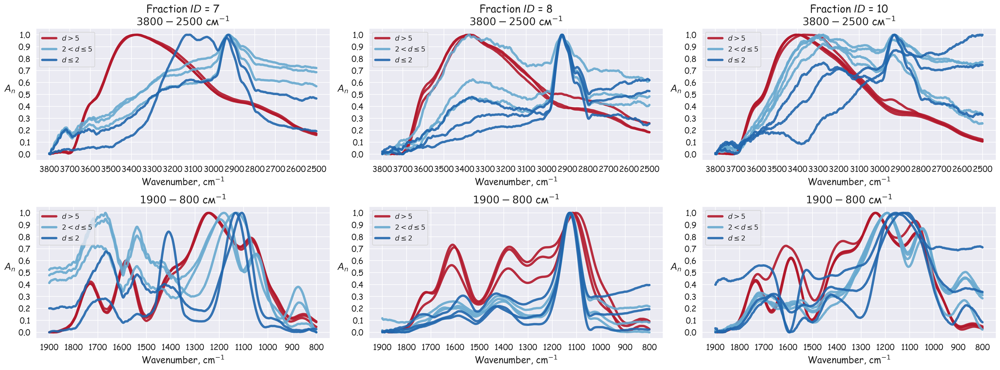

In [18]:
nrows = len(ranges_lst)
ncols = len(divisions_to_plot)

fig_w = 8 * ncols
fig_h = 4.5 * nrows
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(fig_w, fig_h), dpi=300)

# Ensure axes is 2D
axes = np.atleast_2d(axes)

for i, wn_range in enumerate(tqdm(ranges_lst, desc="Plotting")):
    for j, div in enumerate(divisions_to_plot):
        ax = axes[i, j]

        # Select samples for current division
        idx_lst = samples_description.loc[samples_description['Division'] == div].index

        # Select data for current range
        tmp_data_vis = data_scaled_ranges[wn_range].loc[idx_lst]

        # Local plot params with custom title
        local_plot_params = dict(custom_plot_params)
        local_plot_params["TITLE"] = f'${wn_range[0]}-{wn_range[1]}$ см$^{{-1}}$'

        # Plotting spectra
        plot_spectra(
            data_vis=tmp_data_vis,
            ax=ax,
            samples_description=samples_description,
            hue_column='Fraction_grouped_hue',  # Fraction_hue, Fraction_grouped_hue
            plot_params=local_plot_params,
            style_params=custom_style,
            legend_params=custom_legend
        )

        # Add column title (only for the first row)
        if i == 0:
            ax.set_title(f'Fraction $ID$ = {div}\n' + ax.get_title(), fontsize=custom_style["TITLE_FONT_SIZE"], fontstyle='oblique')

plt.tight_layout()
plt.savefig(f'{path_to_save}/scaled_spectra_multi_div_{'-'.join(map(str, divisions_to_plot))}.png', dpi=600)
plt.show()

## Dimensionality reduction

In [19]:
hue = samples_description['Fraction_grouped_hue'].tolist()
target = samples_description['Class'].tolist()

In [20]:
type_color_dict = {
    r'$d \leq 2$': '#2166AC',
    r'$2 < d \leq 5$': '#67A9CF',
    r'$d > 5$': '#B2182B'
}

### Class for dimensionality reduction

In [21]:
class DimensionalityReduction:
    def __init__(self, data, hue=None):
        self.data = data
        self.hue = hue
        self.results = {}

    def _apply_method(self, method, name, target=None, model_args=None):
        model_args = model_args or {}
        valid = inspect.signature(method).parameters
        model = method(**{k: v for k, v in model_args.items() if k in valid})
        transformed = model.fit_transform(self.data, target) if target is not None else model.fit_transform(self.data)
        self.results[name] = pd.DataFrame(transformed, columns=[f"ax_{i}" for i in range(1, transformed.shape[1] + 1)])
        if hasattr(model, "explained_variance_ratio_"):
            self.results[f"{name}_variance"] = [round(v, 4) for v in model.explained_variance_ratio_]

    # compute methods
    def get_pca(self, n_components=2, random_state=42):
        self._apply_method(PCA, "pca", model_args=dict(n_components=n_components, random_state=random_state))

    def get_lda(self, target, n_components=2):
        self._apply_method(LDA, "lda", target=target, model_args=dict(n_components=n_components, solver="svd"))

    def get_nmf(self, n_components=2, random_state=42):
        self._apply_method(NMF, "nmf", model_args=dict(n_components=n_components, init="nndsvd", max_iter=100_000, random_state=random_state))

    def get_tsne(self, n_components=2, learning_rate=200, init="pca", perplexity=5, n_iter=5_000, random_state=42):
        iter_kw = "n_iter" if "n_iter" in inspect.signature(TSNE).parameters else "max_iter"
        self._apply_method(TSNE, "tsne", model_args=dict(
            n_components=n_components, learning_rate=learning_rate, init=init,
            perplexity=perplexity, random_state=random_state, **{iter_kw: n_iter}
        ))

    # single-plot visualization
    def get_visualization(
        self,
        method="pca",
        ax=None,
        figsize=(8, 6),
        palette="Dark2",
        markersize=14,
        fontstyle="normal",
        fontsize=14,
        path_to_save=None,
        dpi=300,
        title=True,
    ):
        if method not in self.results:
            raise ValueError(f"Method {method} has not been applied. Call get_{method}() first.")

        created_fig = ax is None
        if created_fig:
            fig, ax = plt.subplots(figsize=figsize, dpi=dpi)

        data = self.results[method]
        sns.scatterplot(
            data=data,
            x=data.columns[0],
            y=data.columns[1],
            hue=self.hue,
            palette=palette,
            s=markersize,
            ax=ax,
        )

        if method == "pca" and "pca_variance" in self.results:
            var1, var2 = self.results["pca_variance"][:2]
            xlabel = f"Principal component 1\n($PoEV$ = {var1})"
            ylabel = f"Principal component 2\n($PoEV$ = {var2})"
        else:
            xlabel, ylabel = "Axis 1", "Axis 2"

        ax.set_xlabel(xlabel, fontstyle=fontstyle, fontsize=fontsize)
        ax.set_ylabel(ylabel, fontstyle=fontstyle, fontsize=fontsize)
        ax.xaxis.set_major_locator(ticker.MaxNLocator(9))
        ax.yaxis.set_major_locator(ticker.MaxNLocator(9))
        ax.tick_params(axis='both', which='major', labelsize=fontsize)

        if title:
            titles = {"pca": "PCA", "lda": r"LDA", "nmf": r"NMF", "tsne": r"t-SNE"}
            ax.set_title(titles.get(method, method.upper()), fontstyle="normal", fontsize=fontsize, fontweight="bold")

        ax.legend(loc="best", fontsize=max(fontsize - 2, 1), markerscale=0.7)

        if created_fig:
            plt.tight_layout()
            if path_to_save:
                plt.savefig(path_to_save, dpi=dpi)
            plt.show()

    # panel rendering
    def plot_panel(
        self,
        methods,
        nrows=None,
        ncols=None,
        figsize=None,
        dpi=300,
        viz_defaults=None,
        viz_overrides=None,
        axes=None,
        hide_extra_axes=True,
    ):
        if not methods:
            raise ValueError("methods list is empty.")

        viz_defaults = viz_defaults or {}
        viz_overrides = viz_overrides or {}

        missing = [m for m in methods if m not in self.results]
        if missing:
            raise ValueError("These methods were not computed: " + ", ".join(missing) + ". Call corresponding get_*() first.")

        created_fig = False

        if axes is not None:
            axes_np = np.asarray(axes)
            if axes_np.ndim not in (1, 2):
                raise ValueError("axes must be 1D or 2D array-like of matplotlib Axes.")
            ax_list = axes_np.ravel()
            if len(ax_list) < len(methods):
                raise ValueError("Not enough axes for the requested methods.")
            fig = ax_list[0].figure
        else:
            if ncols is None and nrows is None:
                ncols = len(methods); nrows = 1
            elif ncols is None:
                ncols = math.ceil(len(methods) / nrows)
            elif nrows is None:
                nrows = math.ceil(len(methods) / ncols)

            if figsize is None:
                figsize = (6 * ncols, 5 * nrows)

            fig, axes_created = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize, dpi=dpi)
            ax_list = np.atleast_1d(axes_created).ravel()
            created_fig = True

        for ax, method in zip(ax_list, methods):
            kwargs = {**viz_defaults, **viz_overrides.get(method, {})}
            allowed = {"palette", "markersize", "fontstyle", "fontsize", "title", "figsize", "path_to_save", "dpi"}
            vkwargs = {k: v for k, v in kwargs.items() if k in allowed}
            self.get_visualization(method=method, ax=ax, **vkwargs)

        if hide_extra_axes and len(ax_list) > len(methods):
            for ax in ax_list[len(methods):]:
                ax.set_visible(False)

        if created_fig:
            plt.tight_layout()
        return fig

    # back-compat wrapper
    def get_combined_visualization(
        self,
        nrows,
        ncols,
        figsize=(16, 12),
        palette="Dark2",
        markersize=14,
        fontstyle="normal",
        fontsize=14,
        path_to_save=None,
        dpi=300,
        methods=None,
        titles=True,
        axes=None,
    ):
        methods = methods or ["pca", "lda", "nmf", "tsne"]
        fig = self.plot_panel(
            methods=methods,
            nrows=nrows, ncols=ncols,
            figsize=figsize, dpi=dpi,
            viz_defaults=dict(palette=palette, markersize=markersize, fontstyle=fontstyle, fontsize=fontsize, title=titles),
            viz_overrides={},
            axes=axes,
        )
        if path_to_save:
            plt.savefig(path_to_save, dpi=dpi)
        plt.show()

### Low-dimension spectra in *all (5)* ranges

In [22]:
ranges_lst = [
    (3800, 2500),
    (1900, 800),
    (1900, 1500),
    (1500, 1300),
    (1300, 800)
]

In [23]:
hue = samples_description['Fraction_grouped_hue'].tolist()
target = samples_description['Class'].tolist()

In [24]:
methods_order = ['pca', 'tsne', 'lda']

viz_defaults = {
    "palette": type_color_dict,
    "markersize": 256,
    "fontsize": 16,
    "title": True, 
}

viz_overrides = {
    # "tsne": {"markersize": 256},  # example: larger markers for t-SNE
    # "lda": {"palette": "Set2"},
}

WAVENUMBER RANGE: (3800, 2500)


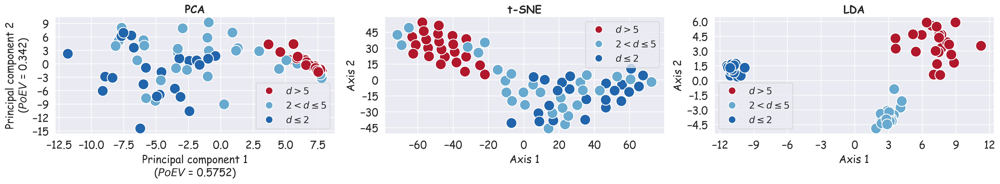

WAVENUMBER RANGE: (1900, 800)


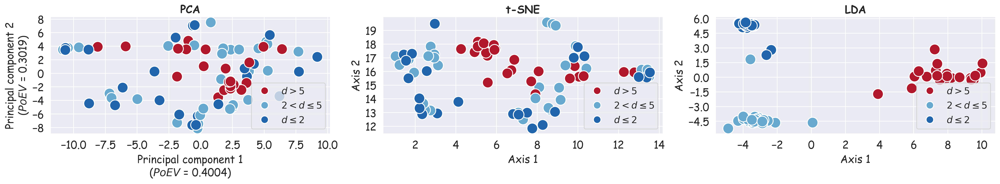

WAVENUMBER RANGE: (1900, 1500)


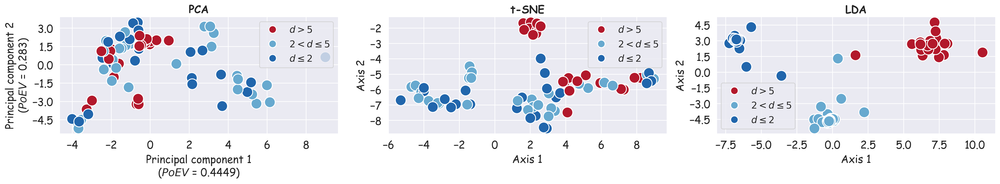

WAVENUMBER RANGE: (1500, 1300)


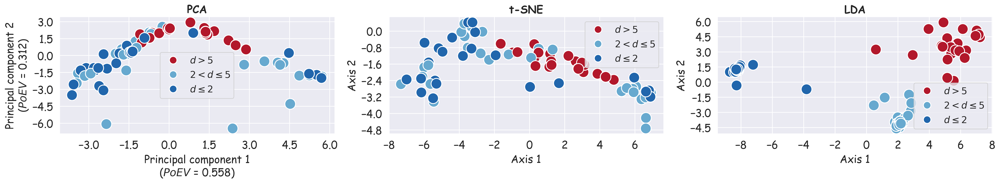

WAVENUMBER RANGE: (1300, 800)


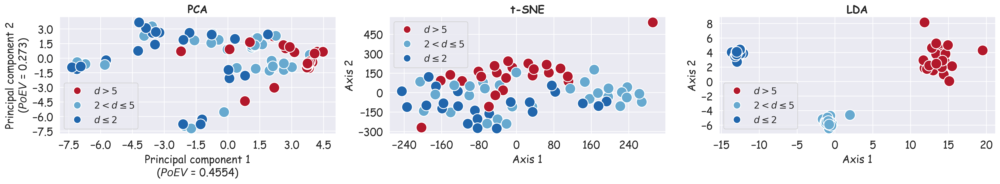

In [25]:
for wn_range in ranges_lst:
    print(f"WAVENUMBER RANGE: {wn_range}")

    data = data_scaled_ranges[wn_range]

    # Compute only requested methods once per range
    dimred = DimensionalityReduction(data=data, hue=hue)
    if 'pca' in methods_order:  dimred.get_pca(n_components=2, random_state=42)
    if 'lda' in methods_order:  dimred.get_lda(target=target, n_components=2)
    if 'nmf' in methods_order:  dimred.get_nmf(n_components=2, random_state=42)
    if 'tsne' in methods_order: dimred.get_tsne(n_components=2, perplexity=25, random_state=42)

    #  grid setup
    nrows, ncols = 1, 3
    capacity = nrows * ncols

    total = len(methods_order)
    pages = math.ceil(total / capacity)

    for p in range(pages):
        start = p * capacity
        end   = min((p + 1) * capacity, total)
        methods_page = methods_order[start:end]

        # Figure size scales with grid
        fig_w, fig_h = 7 * ncols, 4 * nrows
        fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(fig_w, fig_h), dpi=300)

        # Draw directly on provided axes; hide unused cells on last page
        dimred.plot_panel(
            methods=methods_page,
            axes=axes,  # pass full 2D axes array
            viz_defaults={**viz_defaults, "palette": type_color_dict},
            viz_overrides=viz_overrides,
            dpi=1200,
            hide_extra_axes=True,
        )

        plt.tight_layout()

        # Saving image
        base = f"dimred_{wn_range[0]}_{wn_range[1]}_{'_'.join(methods_order)}"
        suffix = "" if pages == 1 else f"_p{p+1}of{pages}"
        out_name = f"{base}{suffix}.svg"

        # plt.savefig(f"{path_to_save}/{out_name}", dpi=600)
        plt.show()


### Sublots for several (*2*) ranges

In [26]:
ranges_lst = [
    (3800, 2500),
    (1900, 800)
]

In [27]:
methods_order = ['pca', 'tsne', 'lda']

viz_defaults = {
    "palette": type_color_dict,
    "markersize": 256,
    "fontsize": 16,
    "title": True, 
}

viz_overrides = {
    # "tsne": {"markersize": 256},  # example: larger markers for t-SNE
    # "lda": {"palette": "Set2"},
}

WAVENUMBER RANGE: (3800, 2500)


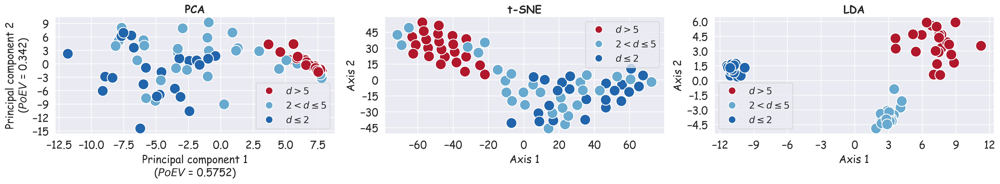

WAVENUMBER RANGE: (1900, 800)


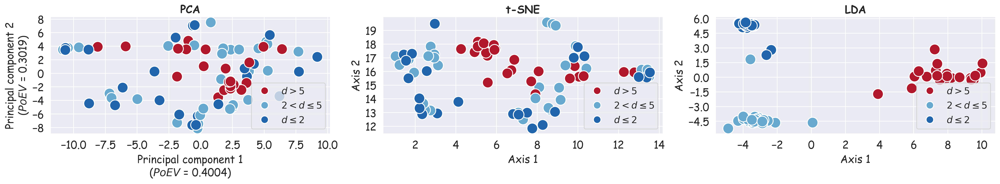

In [28]:
for wn_range in ranges_lst:
    print(f"WAVENUMBER RANGE: {wn_range}")

    data = data_scaled_ranges[wn_range]

    # Compute only requested methods once per range
    dimred = DimensionalityReduction(data=data, hue=hue)
    if 'pca' in methods_order:  dimred.get_pca(n_components=2, random_state=42)
    if 'lda' in methods_order:  dimred.get_lda(target=target, n_components=2)
    if 'nmf' in methods_order:  dimred.get_nmf(n_components=2, random_state=42)
    if 'tsne' in methods_order: dimred.get_tsne(n_components=2, perplexity=25, random_state=42)

    #  grid setup
    nrows, ncols = 1, 3
    capacity = nrows * ncols

    total = len(methods_order)
    pages = math.ceil(total / capacity)

    for p in range(pages):
        start = p * capacity
        end   = min((p + 1) * capacity, total)
        methods_page = methods_order[start:end]

        # Figure size scales with grid
        fig_w, fig_h = 7 * ncols, 4 * nrows
        fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(fig_w, fig_h), dpi=300)

        # Draw directly on provided axes; hide unused cells on last page
        dimred.plot_panel(
            methods=methods_page,
            axes=axes,  # pass full 2D axes array
            viz_defaults={**viz_defaults, "palette": type_color_dict},
            viz_overrides=viz_overrides,
            dpi=1200,
            hide_extra_axes=True,
        )

        plt.tight_layout()

        # Saving image
        base = f"dimred_{wn_range[0]}_{wn_range[1]}_{'_'.join(methods_order)}"
        suffix = "" if pages == 1 else f"_p{p+1}of{pages}"
        out_name = f"{base}{suffix}.svg"
        plt.savefig(f"{path_to_save}/{out_name}", dpi=600)
        plt.show()

## *EDA* pipeline

### Data wrangling

In [29]:
ranges_lst = [
    (3800, 2500),
    (1900, 800)
]

divisions_to_plot = [7, 8, 10]

In [30]:
methods_order_B = ['pca', 'tsne', 'lda']
methods_order_C = ['pca', 'tsne', 'lda']

wn_B = ranges_lst[0]
wn_C = ranges_lst[-1]

nrows_B, ncols_B = 1, 3
nrows_C, ncols_C = 1, 3

dpi = 300

In [31]:
custom_plot_params = {
    # label-config
    'X_LABEL': 'Wavenumber, cm$^{-1}$',
    'Y_LABEL': '$A_{n}$',
    'TITLE': '',
    'Y_LABELPAD': 15,
    'X_LABELPAD': 5,

    # tick-config
    'X_LOCATOR': 'auto', # 'auto' | 'step' | 'linear'
    'Y_LOCATOR': 'auto', # 'auto' | 'step' | 'linear'
    'X_NBINS': None,
    'Y_NBINS': None,
    'X_STEP': 200,
    'Y_STEP': 0.1,
    'X_NUMTICKS': 8,
    'Y_NUMTICKS': None,
    
    # line-style
    'LINEWIDTH': 4.0,
    'ALPHA': 0.9,
    'COLORMAP': type_color_dict # bwr, viridis, twilight, inferno, coolwarm
}

custom_style = {
    'TITLE_FONT_SIZE': 20,
    'Y_LABEL_FONT_SIZE': 18,
    'X_LABEL_FONT_SIZE': 18,
    'X_TICK_FONT_SIZE': 16,
    'Y_TICK_FONT_SIZE': 16
}

custom_legend = {
    'TITLE': '',
    'LOC': 'upper right',
    'NCOL': 1,
    'FONTSIZE': 18,
    'TITLE_FONTSIZE': 20
}

### Panel visualization

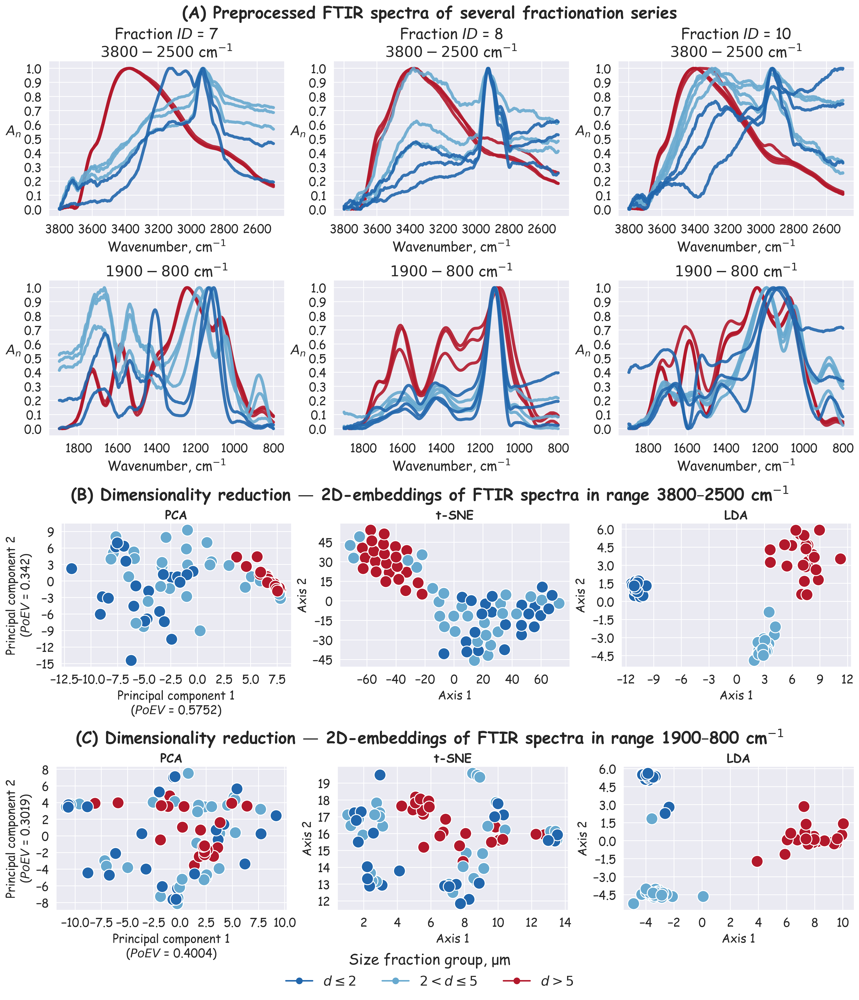

In [32]:
# Creating one figure with 3 subfigures (A, B, C)
fig = plt.figure(figsize=(16, 18), constrained_layout=True, dpi=dpi)
subfigs = fig.subfigures(nrows=3, ncols=1, height_ratios=[2.0, 1.0, 1.0])

# (A) Spectra grid
subfigA = subfigs[0]
nrows_A, ncols_A = 2, 3
axesA = subfigA.subplots(nrows=nrows_A, ncols=ncols_A, squeeze=False)

for i, wn_range in enumerate(ranges_lst):
    for j, div in enumerate(divisions_to_plot):
        ax = axesA[i, j]

        idx_lst = samples_description.loc[samples_description['Division'] == div].index
        tmp_data_vis = data_scaled_ranges[wn_range].loc[idx_lst]

        custom_plot_params["TITLE"] = f'${wn_range[0]}-{wn_range[1]}$ cm$^{{-1}}$'

        plot_spectra(
            data_vis=tmp_data_vis,
            ax=ax,
            samples_description=samples_description,
            hue_column='Fraction_grouped_hue',
            plot_params=custom_plot_params,
            style_params=custom_style,
            legend_params=custom_legend
        )

        # column header only on first row
        if i == 0:
            ax.set_title(f'Fraction $ID$ = {div}\n' + ax.get_title(),
                         fontsize=custom_style["TITLE_FONT_SIZE"], fontstyle='oblique')

# remove local legends in block A
for ax in axesA.ravel():
    leg = ax.get_legend()
    if leg:
        leg.remove()

titleA = subfigA.suptitle(
    "(A) Preprocessed FTIR spectra of several fractionation series",
    fontsize=custom_style["TITLE_FONT_SIZE"] + 2, fontweight="bold"
)

# (B) Dimensionality reduction (3800–2500) panel
subfigB = subfigs[1]
data_B   = data_scaled_ranges[wn_B]
hue_B    = samples_description.loc[data_B.index, 'Fraction_grouped_hue'].tolist()
target_B = samples_description.loc[data_B.index, 'Class'].tolist()

dimred_B = DimensionalityReduction(data=data_B, hue=hue_B)
if 'pca' in methods_order_B:  dimred_B.get_pca(n_components=2, random_state=42)
if 'lda' in methods_order_B:  dimred_B.get_lda(target=target_B, n_components=2)
if 'nmf' in methods_order_B:  dimred_B.get_nmf(n_components=2, random_state=42)
if 'tsne' in methods_order_B: dimred_B.get_tsne(n_components=2, perplexity=25, random_state=42)

axesB = subfigB.subplots(nrows=nrows_B, ncols=ncols_B, squeeze=False)
dimred_B.plot_panel(
    methods=methods_order_B,
    axes=axesB,
    viz_defaults={**viz_defaults, "palette": type_color_dict},
    viz_overrides=viz_overrides,
    dpi=dpi,
    hide_extra_axes=True,
)

# remove local legends in block B
for ax in axesB.ravel():
    leg = ax.get_legend()
    if leg:
        leg.remove()

titleB = subfigB.suptitle(
    f"(B) Dimensionality reduction — 2D-embeddings of FTIR spectra in range 3800–2500 cm$^{{-1}}$",
    fontsize=custom_style["TITLE_FONT_SIZE"] + 2, fontweight="bold"
)

# (C) Dimensionality reduction (1900–800) panel
subfigC = subfigs[2]
data_C   = data_scaled_ranges[wn_C]
hue_C    = samples_description.loc[data_C.index, 'Fraction_grouped_hue'].tolist()
target_C = samples_description.loc[data_C.index, 'Class'].tolist()

dimred_C = DimensionalityReduction(data=data_C, hue=hue_C)
if 'pca' in methods_order_C:  dimred_C.get_pca(n_components=2, random_state=42)
if 'lda' in methods_order_C:  dimred_C.get_lda(target=target_C, n_components=2)
if 'nmf' in methods_order_C:  dimred_C.get_nmf(n_components=2, random_state=42)
if 'tsne' in methods_order_C: dimred_C.get_tsne(n_components=2, perplexity=25, random_state=42)

axesC = subfigC.subplots(nrows=nrows_C, ncols=ncols_C, squeeze=False)
dimred_C.plot_panel(
    methods=methods_order_C,
    axes=axesC,
    viz_defaults={**viz_defaults, "palette": type_color_dict},
    viz_overrides=viz_overrides,
    dpi=dpi,
    hide_extra_axes=True,
)

# remove local legends in block C
for ax in axesC.ravel():
    leg = ax.get_legend()
    if leg:
        leg.remove()

titleC = subfigC.suptitle(
    f"(C) Dimensionality reduction — 2D-embeddings of FTIR spectra in range 1900–800 cm$^{{-1}}$",
    fontsize=custom_style["TITLE_FONT_SIZE"] + 2, fontweight="bold"
)

# Global legend at the bottom
labels = list(type_color_dict.keys())
colors = [type_color_dict[k] for k in labels]
handles = [
    Line2D([0], [0], color=c, marker='o', linestyle='-', linewidth=2, markersize=8, label=lab)
    for lab, c in zip(labels, colors)
]

leg = fig.legend(
    handles=handles,
    labels=labels,
    title='Size fraction group, μm',
    loc='lower center',
    ncol=len(labels),
    title_fontsize=custom_legend['TITLE_FONTSIZE'],
    fontsize=custom_legend['FONTSIZE'],
    bbox_to_anchor=(0.5, -0.04),
    frameon=False
)

# Saving and plotting figure
plt.savefig(
    f"{path_to_save}/panel_eda_{wn_B[0]}_{wn_B[1]}__{wn_C[0]}_{wn_C[1]}.png",
    bbox_inches='tight',
    bbox_extra_artists=(leg, titleA, titleB, titleC),
    dpi=1200
)
plt.show()

# Additional analysis — heat maps

## Base function 

### Heat map plotting

In [42]:
def plot_spectra_heatmap(
    data_vis, ax,
    samples_description=None, hue_column=None,
    style_params=None, plot_params=None, legend_params=None, cbar_params=None
):
    # style/config dicts
    if style_params is None:
        raise ValueError("style_params must be provided explicitly (no defaults).")
    if plot_params is None:
        raise ValueError("plot_params must be provided explicitly (no defaults).")
    if legend_params is None:
        raise ValueError("legend_params must be provided explicitly (no defaults).")
    if cbar_params is None:
        raise ValueError("cbar_params must be provided explicitly (no defaults).")

    # row order and group colors
    row_order = list(data_vis.index)
    row_colors = None
    group_names = None
    group_cmap = plot_params.get("ROW_COLORMAP", None)  # dict {group -> color} or None
    
    if samples_description is not None and hue_column is not None:
        hue = samples_description.loc[data_vis.index, hue_column].astype(str)
        # sort by group, then by index for a stable block structure
        row_order = sorted(data_vis.index, key=lambda idx: (hue.loc[idx], str(idx)))
        group_names = [hue.loc[idx] for idx in row_order]
    
        # build a group palette and FORCE RGBA floats
        if isinstance(group_cmap, dict):
            # convert any hex/strings to RGBA tuples of floats
            group_palette = {k: mcolors.to_rgba(v) for k, v in group_cmap.items()}
        else:
            uniq = list(dict.fromkeys([hue.loc[i] for i in row_order]))
            colors_arr = cm.get_cmap(plot_params.get("GROUP_CMAP_NAME", "Set2"))(
                np.linspace(0.15, 0.85, len(uniq))
            )
            # ensure tuples (R,G,B,A) of floats
            group_palette = dict(zip(uniq, [tuple(c) for c in colors_arr]))
    
        row_colors = [group_palette[g] for g in group_names]


    # x_axis (wavenumbers) — we only need it for labeling; axis is inverted below
    try:
        x_vals = np.asarray(data_vis.columns, dtype=float)
    except Exception:
        # fallback if columns are not castable to float (e.g., LaTeX-like strings)
        x_vals = np.arange(len(data_vis.columns))

    # data matrix in the desired row order
    M = data_vis.loc[row_order, data_vis.columns].values

    # draw heatmap
    im = ax.imshow(
        M,
        aspect="auto",
        origin="upper",
        cmap=plot_params.get("HEATMAP_CMAP", "magma"),
        vmin=plot_params.get("VMIN", None),
        vmax=plot_params.get("VMAX", None),
        interpolation=plot_params.get("INTERPOLATION", "nearest"),
    )

    # axes styling
    ax.set_title(plot_params.get("TITLE", ""), fontsize=style_params["TITLE_FONT_SIZE"], fontstyle="normal")
    ax.set_xlabel(plot_params.get("X_LABEL", "Wavenumber, cm$^{-1}$"),
                  fontsize=style_params["X_LABEL_FONT_SIZE"], labelpad=plot_params.get("X_LABELPAD", 5))
    ax.set_ylabel(plot_params.get("Y_LABEL", "Samples"),
                  fontsize=style_params["Y_LABEL_FONT_SIZE"], labelpad=plot_params.get("Y_LABELPAD", 12))

    # x_ticks
    if plot_params.get("X_LOCATOR") == "linear":
        ax.xaxis.set_major_locator(ticker.LinearLocator(numticks=plot_params.get("X_NUMTICKS", 8)))
    elif plot_params.get("X_STEP") is not None:
        ax.xaxis.set_major_locator(ticker.MultipleLocator(plot_params["X_STEP"]))
    else:
        ax.xaxis.set_major_locator(ticker.MaxNLocator(nbins=plot_params.get("X_NBINS", 8)))

    # y_ticks (for heatmaps we usually hide, or show only a few)
    if plot_params.get("Y_SHOW_TICKS", False):
        ax.yaxis.set_major_locator(ticker.MaxNLocator(nbins=plot_params.get("Y_NBINS", 6)))
        ax.tick_params(axis="y", labelsize=style_params["Y_TICK_FONT_SIZE"])
    else:
        ax.set_yticks([])

    ax.tick_params(axis="x", labelsize=style_params["X_TICK_FONT_SIZE"])

    # invert X axis for IR convention (4000 → 400 to the right)
    ax.invert_xaxis()

    # optional left-side group stripe (mini-heatmap of row colors)
    if row_colors is not None and plot_params.get("SHOW_ROW_STRIPE", True):
        divider = make_axes_locatable(ax)
        ax_colors = divider.append_axes("left", size=plot_params.get("ROW_STRIPE_WIDTH", 0.12), pad=0.05)
        # make sure it's float (N, 1, 4)
        stripe_img = np.asarray(row_colors, dtype=float).reshape(len(row_colors), 1, 4)
        ax_colors.imshow(stripe_img, aspect="auto", origin="upper")
        ax_colors.set_xticks([])
        ax_colors.set_yticks([])
        for spine in ax_colors.spines.values():
            spine.set_visible(False)

    # group legend (patches)
    if row_colors is not None and legend_params.get("SHOW_LEGEND", True):
        uniq_groups = []
        for g in group_names:
            if g not in uniq_groups:
                uniq_groups.append(g)
        handles = [mpatches.Patch(color=mcolors.to_rgba(group_palette[g]), label=g) for g in uniq_groups]
        ax.legend(
            handles=handles,
            title=legend_params.get("TITLE", ""),
            loc=legend_params.get("LOC", "upper right"),
            ncol=legend_params.get("NCOL", 1),
            title_fontsize=legend_params.get("TITLE_FONTSIZE", 12),
            fontsize=legend_params.get("FONTSIZE", 11),
            frameon=False
        )

    # colorbar
    cbar = plt.colorbar(
        im, ax=ax,
        orientation=cbar_params.get("ORIENTATION", "vertical"),
        pad=cbar_params.get("PAD", 0.02),
        fraction=cbar_params.get("FRACTION", 0.05)
    )
    cbar.set_label(cbar_params.get("LABEL", "Normalized absorbance"), fontsize=cbar_params.get("LABELSIZE", 12))
    cbar.ax.tick_params(labelsize=cbar_params.get("TICKSIZE", 10))

### Creating annotation

In [43]:
def add_annotation(ax, text, xy=(0.013, 0.98), fontsize=12, facecolor='white', edgecolor='black', alpha=0.5):
    ax.annotate(
        text=text, xy=xy, xycoords='axes fraction',
        fontsize=fontsize, fontweight='bold', color='black',
        ha='left', va='top',
        bbox={'facecolor': facecolor, 'edgecolor': edgecolor, 'boxstyle': 'round', 'alpha': alpha}
    )

## Spectra in *all (5)* ranges

In [51]:
heatmap_plot_params = {
    # label-config
    'TITLE': '',
    'X_LABEL': 'Wavenumber, cm$^{-1}$',
    'Y_LABEL': 'Samples',
    'X_LABELPAD': 5,
    'Y_LABELPAD': 12,

    # tick-config
    'X_LOCATOR': 'linear',   # 'auto' | 'step' | 'linear'
    'X_NBINS': 8,
    'X_STEP': None,
    'X_NUMTICKS': 8,
    'Y_SHOW_TICKS': False,   # hide by default
    'Y_NBINS': 6,

    # heatmap-config
    'HEATMAP_CMAP': 'bwr',  # e.g., 'inferno', 'viridis'
    'VMIN': None,             # set to 0.0 for fixed MinMax range, if needed
    'VMAX': None,             # set to 1.0 for fixed MinMax range, if needed
    'INTERPOLATION': 'nearest',

    # row/group colors
    'ROW_COLORMAP': type_color_dict,  # dict {group -> color}, or None
    'GROUP_CMAP_NAME': 'Set2',

    # side stripe for groups
    'SHOW_ROW_STRIPE': True,
    'ROW_STRIPE_WIDTH': 0.12
}

heatmap_style = {
    'TITLE_FONT_SIZE': 18,
    'Y_LABEL_FONT_SIZE': 16,
    'X_LABEL_FONT_SIZE': 16,
    'X_TICK_FONT_SIZE': 12,
    'Y_TICK_FONT_SIZE': 12
}

heatmap_legend = {
    'TITLE': '',
    'LOC': 'upper right',
    'NCOL': 1,
    'FONTSIZE': 12,
    'TITLE_FONTSIZE': 14,
    'SHOW_LEGEND': True,
    'SHOW_STRIPE_LABEL': False,
    'STRIPE_LABEL': 'Group'
}

heatmap_cbar = {
    'LABEL': 'Normalized absorbance',
    'ORIENTATION': 'vertical',
    'PAD': 0.02,
    'FRACTION': 0.05,
    'TICKSIZE': 10,
    'LABELSIZE': 12
}

In [52]:
ranges_lst = [
    (3800, 2500),
    (1900, 800),
    (1900, 1500),
    (1500, 1300),
    (1300, 800)
]

In [53]:
nrows = len(divisions_lst)
ncols = len(ranges_lst)

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols * 6, nrows * 3.2), dpi=300)

for i, division in enumerate(divisions_lst):

    # Selecting index for current division
    idx_lst = samples_description.loc[samples_description['Division'] == division].index

    # Visualization
    for j, wn_range in enumerate(ranges_lst):

        tmp_data_vis = data_scaled_ranges[wn_range].loc[idx_lst]

        if i > 0:
            heatmap_plot_params["TITLE"] = ''
        else:
            heatmap_plot_params["TITLE"] = f'${wn_range[0]}-{wn_range[1]}$ cm$^{{-1}}$'

        plot_spectra_heatmap(
            data_vis=tmp_data_vis,
            ax=axes[i][j],
            samples_description=samples_description,
            hue_column='Fraction_grouped_hue',  # same hue column as in the line plot
            plot_params=heatmap_plot_params,
            style_params=heatmap_style,
            legend_params=heatmap_legend,
            cbar_params=heatmap_cbar
        )

    # Annotation
    add_annotation(
        ax=axes[i, 0],
        text='$ID_{div}$ = ' + f'{division}',
        xy=(0.013, 0.98),
        fontsize=heatmap_style['TITLE_FONT_SIZE'] - 6
    )

plt.tight_layout()
plt.show()